In [2]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [23]:
df = pd.read_csv('train.csv')
df

,ID,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,0,Resort Hotel,0,342,2015,July,27,1,0,0,...,No Deposit,NaN,NaN,0,Transient,-6.305161,0,0,Check-Out,2015-07-01
1,1,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,75.052227,0,0,Check-Out,2015-07-03
2,2,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,74.546401,0,0,Check-Out,2015-07-03
3,3,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,76.376288,0,0,Check-Out,2015-07-03
4,4,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,49.411647,0,0,Check-Out,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91526,91526,Resort Hotel,1,19,2017,March,13,31,0,2,...,No Deposit,250.0,NaN,0,Transient,79.223571,0,1,Canceled,2017-03-22
91527,91527,Resort Hotel,0,28,2017,March,13,31,0,2,...,No Deposit,NaN,NaN,0,Transient,-6.822102,0,0,Check-Out,2017-04-02
91528,91528,Resort Hotel,0,2,2017,March,13,31,0,1,...,No Deposit,NaN,NaN,0,Transient,90.814554,0,2,Check-Out,2017-04-01
91529,91529,Resort Hotel,0,30,2017,March,13,31,3,7,...,No Deposit,250.0,NaN,0,Transient,38.135565,0,1,Check-Out,2017-04-10


In [5]:
print("# of NaN in each columns:", df.isnull().sum(), sep='\n')

# of NaN in each columns:
ID                                    0
hotel                                 0
is_canceled                           0
lead_time                             0
arrival_date_year                     0
arrival_date_month                    0
arrival_date_week_number              0
arrival_date_day_of_month             0
stays_in_weekend_nights               0
stays_in_week_nights                  0
adults                                0
children                              4
babies                                0
meal                                  0
country                             468
market_segment                        0
distribution_channel                  0
is_repeated_guest                     0
previous_cancellations                0
previous_bookings_not_canceled        0
reserved_room_type                    0
assigned_room_type                    0
booking_changes                       0
deposit_type                          0
agent         

In [153]:
data = df.copy()

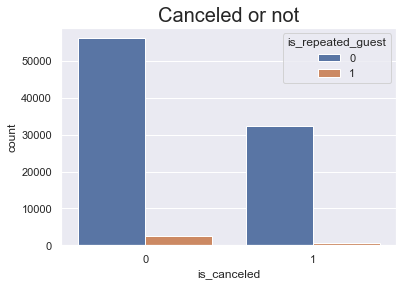

In [7]:
sns.set(style = "darkgrid")
plt.title("Canceled or not", fontdict = {'fontsize': 20})
ax = sns.countplot(x = "is_canceled", hue = 'is_repeated_guest', data = data)

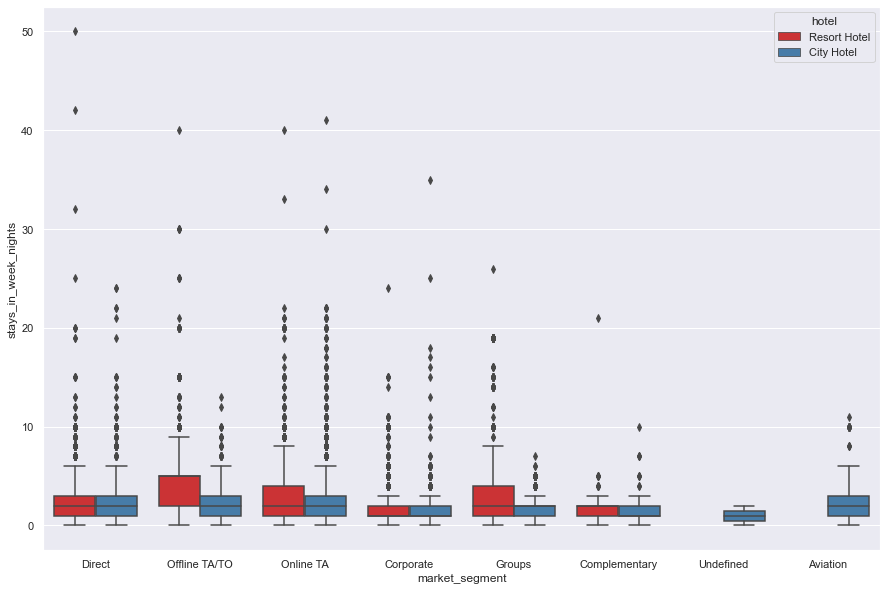

In [8]:
plt.figure(figsize = (15,10))
sns.boxplot(x = "market_segment", y = "stays_in_week_nights", data = data, hue = "hotel", palette = 'Set1')

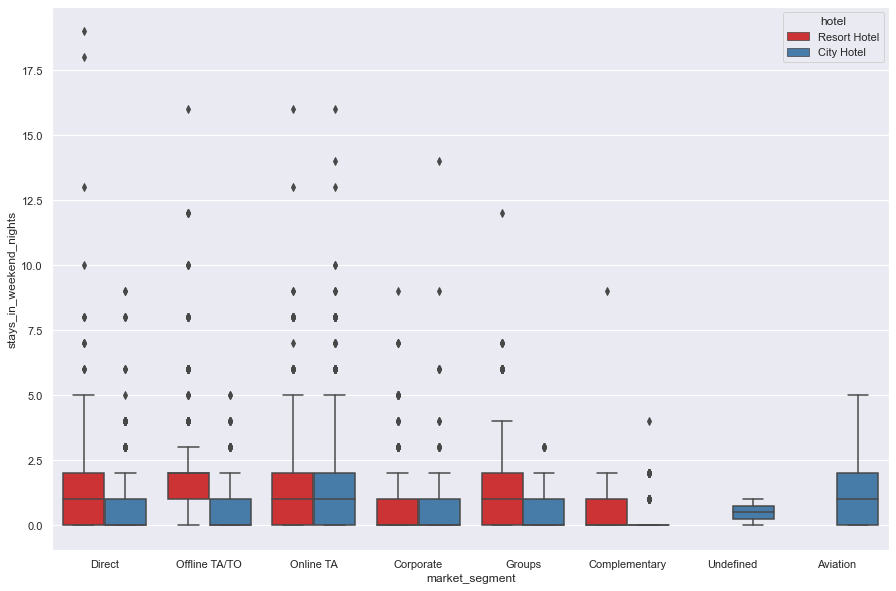

In [9]:
plt.figure(figsize=(15,10))
sns.boxplot(x = "market_segment", y = "stays_in_weekend_nights", data = data, hue = "hotel", palette = 'Set1')

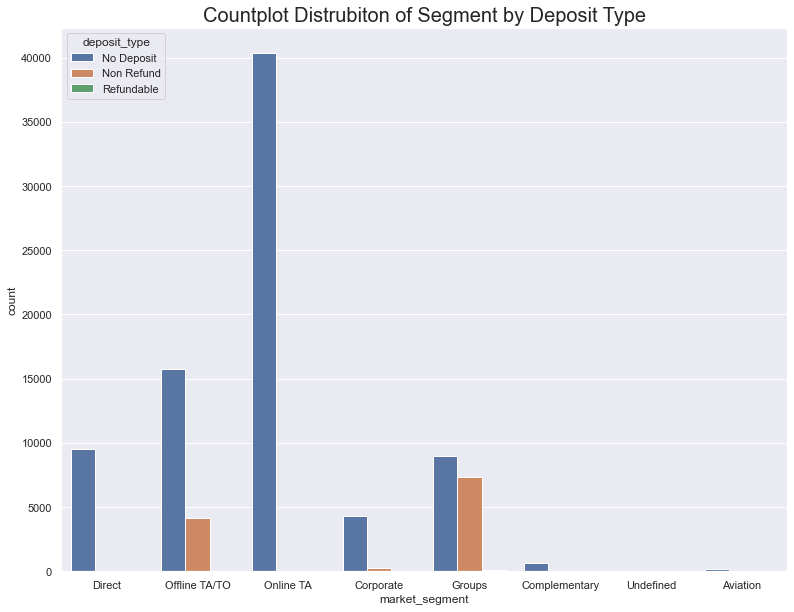

In [10]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distrubiton of Segment by Deposit Type", fontdict = {'fontsize':20})
ax = sns.countplot(x = "market_segment", hue = 'deposit_type', data = data)

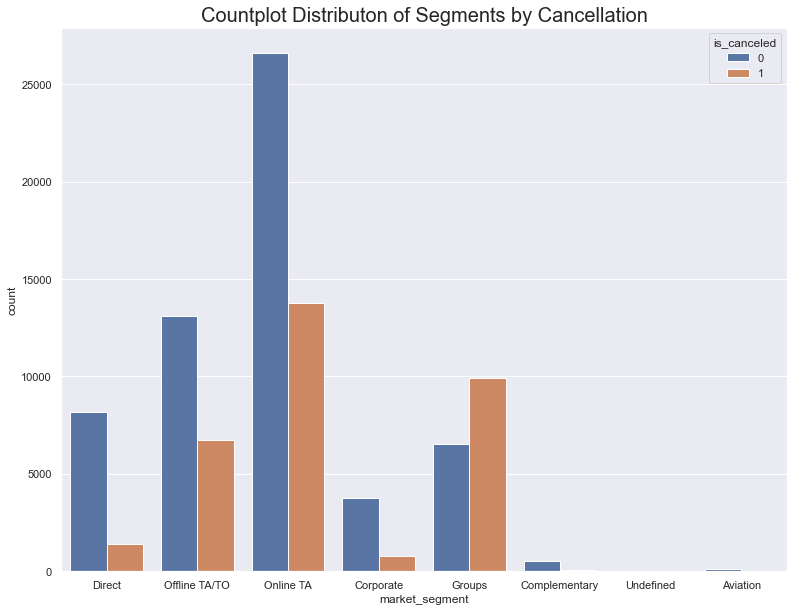

In [12]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distributon of Segments by Cancellation", fontdict = {'fontsize':20})
ax = sns.countplot(x = "market_segment", hue = 'is_canceled', data = data)

In [9]:
df_test = pd.read_csv('test.csv')
print("shape of train: " + str(df.shape))
print("shape of test: " + str(df_test.shape))

print("columns that do not exist in test data: " + str(list(set(list(df)) - set(list(df_test)))))

shape of train: (91531, 33)
shape of test: (27859, 29)
columns that do not exist in test data: ['reservation_status', 'reservation_status_date', 'adr', 'is_canceled']


## Data Correctness 

First, we matched the date difference (checkout - arrival) vs sum of week nights and found 23 rows un-matched. We drop all unmatched rows.

Then, we matched the columns is_canceled vs reservation_status and luckily they are all matched. We also confirmed that all no-show bookings are canceled.

Lastly, we checked if data is reasonable. The number of rows with negative ADR is 2103 (after dropping previous rows). We drop these rows too. 

In [154]:
# Add arrival_date column (year-month-day)
from datetime import datetime
from datetime import date

def combine_to_date(row):
    # year, month, day -> y-m-d
    return str(row['arrival_date_year']) + "-" \
    + str(row['arrival_date_month']) + "-" \
    + str(row['arrival_date_day_of_month'])
def str_to_datetime(input_date):
    return datetime.strptime(input_date,"%Y-%m-%d")
def calculate_date_diff(row):
    if row['reservation_status'] != 'Check-Out':
        return 0
    return float((str_to_datetime(str(row['reservation_status_date'])) - str_to_datetime(str(row['arrival_date']))).days)
def subtract_date_diff_and_week_nights(row):
    if row['reservation_status'] != 'Check-Out':
        return 0
    return float(row['date_diff'] - (row['stays_in_week_nights'] + row['stays_in_weekend_nights']))
def sum_all_nights(row):
    return float(row['stays_in_week_nights'] + row['stays_in_weekend_nights'])

In [187]:
# replace month with number
data['arrival_date_month'].replace({'January' : 1,
        'February' : 2,
        'March' : 3,
        'April' : 4,
        'May' : 5,
        'June' : 6,
        'July' : 7,
        'August' : 8,
        'September' : 9, 
        'October' : 10,
        'November' : 11,
        'December' : 12}, inplace=True)
data["arrival_date_month"] = pd.to_numeric(data["arrival_date_month"])

In [156]:
data['arrival_date'] = data.apply(combine_to_date, axis=1)

In [158]:
data['stays_in_week_nights'] + data['stays_in_weekend_nights']
data['date_diff'] = data.apply(calculate_date_diff, axis=1)
data['total_nights'] = data.apply(sum_all_nights, axis=1)
print("type of date diff is " + str(data['date_diff'].dtype))
print("number of date diff that is less than zero (should be 0): "+str(len(data[data['date_diff'] < 0])))

type of date diff is float64
number of date diff that is less than zero (should be 0): 0


number of data that the Date difference vs week nights are not matched: 23
number of rows left after dropping dates diff: 91508


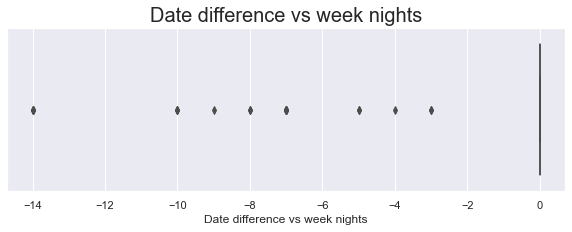

In [163]:
data['Date difference vs week nights'] = data.apply(subtract_date_diff_and_week_nights, axis=1)

plt.figure(figsize = (10,3))
sns.set(style = "darkgrid")
plt.title("Date difference vs week nights", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['Date difference vs week nights'])

tmp = data[data['Date difference vs week nights'] != 0]

print("number of data that the Date difference vs week nights are not matched: " + str(len(tmp)))

# drop all rows where date difference vs week nights != 0
data = data[data['Date difference vs week nights'] == 0]
print("number of rows left after dropping dates diff: " + str(len(data)))

In [164]:
print("number of unmatched cancel status: " + str(len(data[(data['is_canceled'] == 0) & (data['reservation_status'] == 'Canceled')])))
print("check if all no-show bookings are canceled (should be 0): "+ str(len(data[(data['is_canceled'] == 0) & (data['reservation_status'] == 'No-Show')])))


number of unmatched cancel status: 0
check if all no-show bookings are canceled (should be 0): 0


In [165]:
print("number of ADR that is negative (we should drop this since ADR should not be negative): " + str(len(data[data['adr'] < 0])))

# drop all negative ADR
data = data[data['adr'] >= 0]
print("number of rows left after dropping negative ADR: " + str(len(data)))

number of ADR that is negative (we should drop this since ADR should not be negative): 2103
number of rows left after dropping negative ADR: 89405


All hotel is Resort Hotel or City Hotel: True
All is_canceled is 0 or 1: True
All lead_time is above 0: True
All arrival_date_year is 2015 / 2016 / 2017: True
All arrival_date_month is from 1 to 12: True
All arrival_date_week_number is from 1 to 53: True
All arrival_date_day_of_month is from 1 to 31: True
All stays_in_weekend_nights is from 0 to 19: True
All stays_in_week_nights is from 0 to 50: True


## Removing outliers

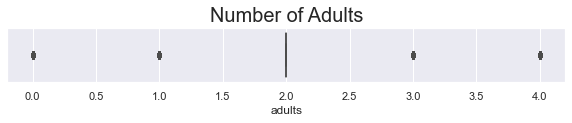

In [220]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Number of Adults", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['adults'])

In [212]:
# This data is weird. A lot of adults but small ADR
print(data[data['adults'] > 20][['hotel','adr', 'adults']])

# drop it
data = data[data['adults'] < 20]
print("number of rows left after drop: " + str(len(data)))

Empty DataFrame
Columns: [hotel, adr, adults]
Index: []
number of rows left after drop: 89404


            hotel          adr  total_ppl
31980  City Hotel  5399.424061        2.0
number of rows left after drop: 89403


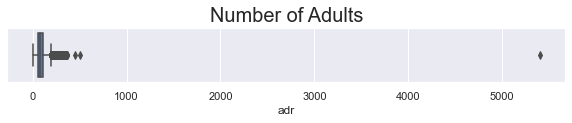

In [232]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Number of Adults", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['adr'])

# This data is weird. Only two people with extremely high ADR.
print(data[data['adr'] > 5000][['hotel','adr', 'total_ppl']])
# drop it
data = data[data['adr'] < 5000]
print("number of rows left after drop: " + str(len(data)))

           adr  children  adults  babies         hotel
864  72.825302      10.0       2       0  Resort Hotel
              adr  children  adults  babies         hotel arrival_date
864     72.825302      10.0       2       0  Resort Hotel    2015-7-12
5049   165.702253       3.0       2       0  Resort Hotel    2015-8-17
18997   87.872509       3.0       2       0  Resort Hotel   2015-11-28
22037  122.306054       3.0       2       0  Resort Hotel     2016-1-1
25768  149.740446       3.0       2       0  Resort Hotel    2016-2-13
32519   89.501588       3.0       2       0  Resort Hotel    2016-3-29
36838  120.249390       3.0       2       0  Resort Hotel    2016-4-23
40909  139.978948       3.0       2       0  Resort Hotel    2016-5-15
47958  167.683797       3.0       2       0  Resort Hotel    2016-6-23
48799   93.385556       3.0       2       0  Resort Hotel    2016-6-28
53581  216.441723       3.0       2       0  Resort Hotel    2016-7-30
58782  305.923201       3.0       2   

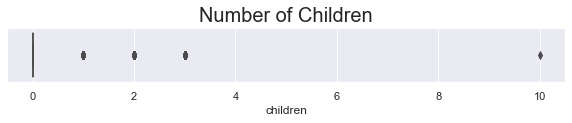

In [285]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Number of Children", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['children'])

# This data is weird. There are 10 childrens and total ppl 12, but the ADR is less than total ppl 
print(data[data['children'] > 3][['adr', 'children', 'adults', 'babies', 'hotel']])
print(data[(data['adults'] == 2) & (data['babies'] == 0) & (data['hotel'] == 'Resort Hotel') & (data['children'] > 2)][['adr', 'children', 'adults', 'babies', 'hotel', 'arrival_date']])

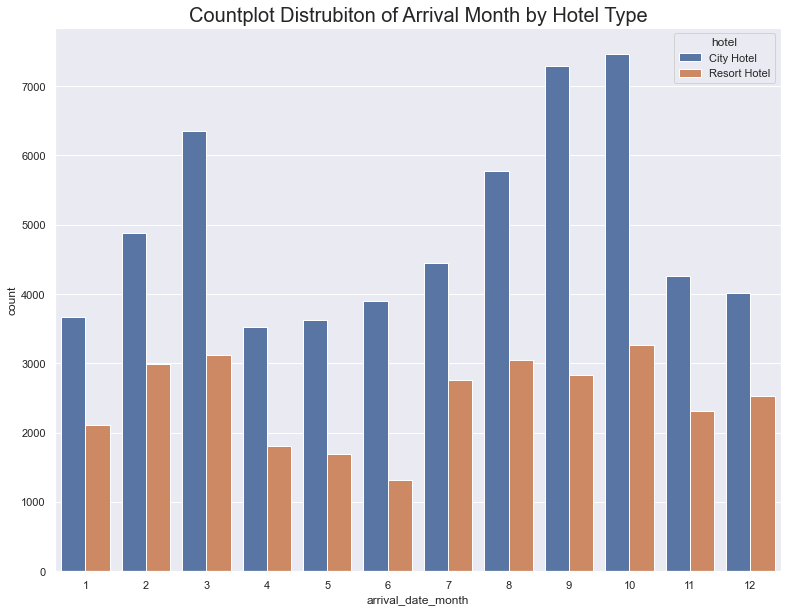

In [298]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distrubiton of Arrival Month by Hotel Type", fontdict = {'fontsize':20})
ax = sns.countplot(x = "arrival_date_month", hue = 'hotel', data = data)

In [308]:
month_to_total_bookings = data.groupby(by='arrival_date_month').size()
month_to_total_bookings

arrival_date_month
1      5783
2      7876
3      9482
4      5338
5      5310
6      5214
7      7215
8      8829
9     10135
10    10732
11     6581
12     6542
dtype: int64

In [237]:
# add one column that contains total number of people
def calculate_total_ppl(row):
    return row['adults'] + row['children'] + row['babies']
data['total_ppl'] = data.apply(calculate_total_ppl, axis=1)

# add one column that contains total cost per booking
def calculate_total_cost(row):
    if row['is_canceled'] == 1:
        return 0
    return row['adr'] * row['total_nights']
data['total_cost'] = data.apply(calculate_total_cost, axis=1)

In [256]:
# This type of data with total cost 0 and is not canceled is also weird (check in and out on the same day)
print(data[(data['total_cost'] == 0) & (data['is_canceled'] == 0)])

# drop it 
data = data[~((data['total_cost'] == 0) & (data['is_canceled'] == 0))]
print("number of rows dropped: " + str(len(data[(data['total_cost'] == 0) & (data['is_canceled'] == 0)])))
print("number of rows left after drop: " + str(len(data)))

Empty DataFrame
Columns: [ID, hotel, is_canceled, lead_time, arrival_date_year, arrival_date_month, arrival_date_week_number, arrival_date_day_of_month, stays_in_weekend_nights, stays_in_week_nights, adults, children, babies, meal, country, market_segment, distribution_channel, is_repeated_guest, previous_cancellations, previous_bookings_not_canceled, reserved_room_type, assigned_room_type, booking_changes, deposit_type, agent, company, days_in_waiting_list, customer_type, adr, required_car_parking_spaces, total_of_special_requests, reservation_status, reservation_status_date, arrival_date, date_diff, total_nights, Date difference vs week nights, total_ppl, total_cost]
Index: []

[0 rows x 39 columns]
number of rows dropped: 0
number of rows left after drop: 89037


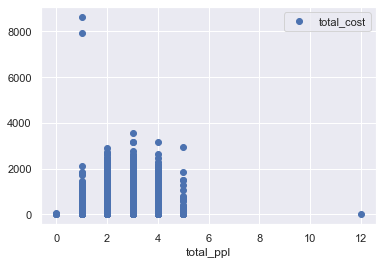

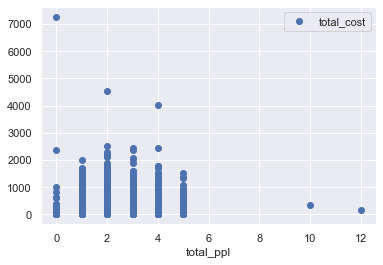

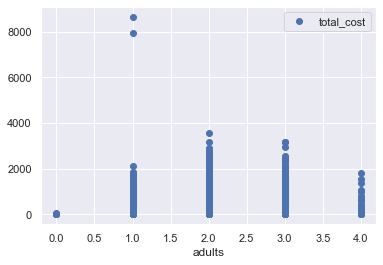

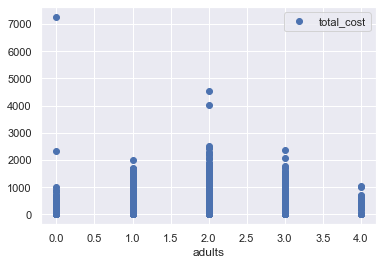

In [310]:
# show correlation of total_ppl and ADR

# for resort hotel
data[data['hotel'] == 'Resort Hotel'].plot(x='total_ppl', y='total_cost', style='o')

# for city hotel
data[data['hotel'] == 'City Hotel'].plot(x='total_ppl', y='total_cost', style='o')

# show correlation of adults and ADR

# for resort hotel
data[data['hotel'] == 'Resort Hotel'].plot(x='adults', y='total_cost', style='o')

# for city hotel
data[data['hotel'] == 'City Hotel'].plot(x='adults', y='total_cost', style='o')

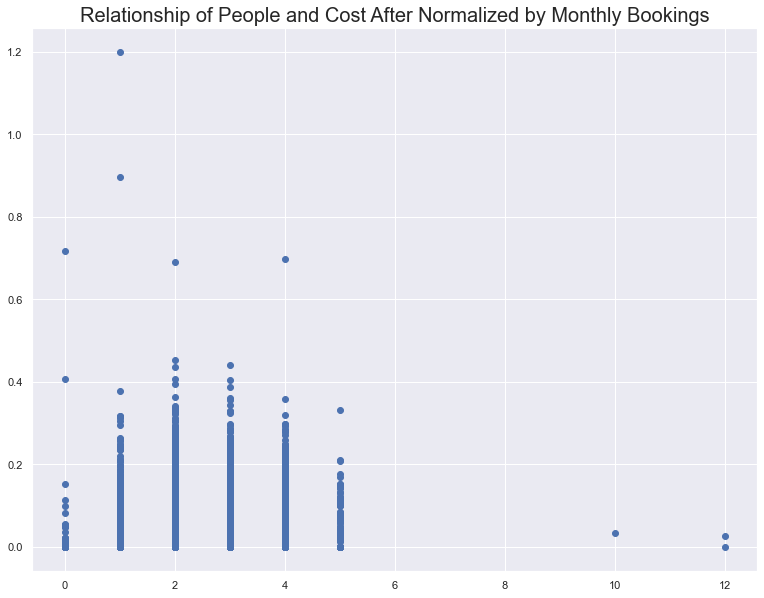

In [328]:
plt.figure(figsize = (13,10))
plt.title("Relationship of People and Cost After Normalized by Monthly Bookings", fontdict = {'fontsize':20})

def normalized_cost(row):
    return row['total_cost']/(month_to_total_bookings[row['arrival_date_month']])
# data.apply(normalized_cost, axis=1)

plt.scatter(data['total_ppl'], data.apply(normalized_cost, axis=1))

## Make sure all data values are as expected 

In [215]:
print("All hotel is Resort Hotel or City Hotel: "+ str(len(data[~data['hotel'].isin(['Resort Hotel', 'City Hotel'])]) == 0))
print("All is_canceled is 0 or 1: "+ str(len(data[~data['is_canceled'].isin([0, 1])]) == 0))
print("All lead_time is above 0: "+ str(len(data[~data['lead_time'] >= 0]) == 0))
print("All arrival_date_year is 2015 / 2016 / 2017: "+ str(len(data[~data['arrival_date_year'].isin([2015, 2016, 2017])]) == 0))
print("All arrival_date_month is from 1 to 12: "+ str(len(data[~data['arrival_date_month'].isin(list(range(1, 13)))]) == 0))
print("All arrival_date_week_number is from 1 to 53: "+ str(len(data[~data['arrival_date_week_number'].isin(list(range(1, 54)))]) == 0))
print("All arrival_date_day_of_month is from 1 to 31: "+ str(len(data[~data['arrival_date_day_of_month'].isin(list(range(1, 32)))]) == 0))
print("All stays_in_weekend_nights is from 0 to 19: "+ str(len(data[~data['stays_in_weekend_nights'].isin(list(range(0, 20)))]) == 0))
print("All stays_in_week_nights is from 0 to 50: "+ str(len(data[~data['stays_in_week_nights'].isin(list(range(0, 51)))]) == 0))
print("All adults is from 0 to 4: "+ str(len(data[~data['adults'].isin(list(range(0, 5)))]) == 0))
print("All children is from 0 to 4: "+ str(len(data[~data['children'].isin(list(range(0, 5)))]) == 0))

All hotel is Resort Hotel or City Hotel: True
All is_canceled is 0 or 1: True
All lead_time is above 0: True
All arrival_date_year is 2015 / 2016 / 2017: True
All arrival_date_month is from 1 to 12: True
All arrival_date_week_number is from 1 to 53: True
All arrival_date_day_of_month is from 1 to 31: True
All stays_in_weekend_nights is from 0 to 19: True
All stays_in_week_nights is from 0 to 50: True
All adults is from 0 to 4: True


In [21]:
# daily revenue = if no cancellation, on the arrival date = ADR * number of days stayed (week + weekend)  